# Unit 5 - Financial Planning


In [1]:
# Initial imports
import os
import requests
import pandas as pd
from dotenv import load_dotenv
import alpaca_trade_api as tradeapi
from MCForecastTools import MCSimulation

%matplotlib inline

In [2]:
# Load .env enviroment variables
load_dotenv()

True

## Part 1 - Personal Finance Planner

### Collect Crypto Prices Using the `requests` Library

In [3]:
# Set current amount of crypto assets
# YOUR CODE HERE!

my_btc = 1.2
my_eth = 5.3


In [4]:
# Crypto API URLs
btc_url = "https://api.alternative.me/v2/ticker/Bitcoin/?convert=USD"
eth_url = "https://api.alternative.me/v2/ticker/Ethereum/?convert=USD"

In [5]:
# Fetch current BTC price
# YOUR CODE HERE!

import json

btc_res = requests.get(btc_url)
btc_data = btc_res.json()
btc_json = json.dumps(btc_data, indent=2)

btc_price = btc_data['data']['1']['quotes']['USD']['price']

# print(btc_price)

# Fetch current ETH price
# YOUR CODE HERE!]

eth_res = requests.get(eth_url)
eth_data = eth_res.json()
eth_json = json.dumps(eth_data, indent=2)

eth_price = eth_data['data']['1027']['quotes']['USD']['price']

# print(eth_price)

# Compute current value of my crpto
# YOUR CODE HERE!

btc_value = btc_price * my_btc
eth_value = eth_price * my_eth

crypto_value = btc_value + eth_value

# Print current crypto wallet balance
print(f"The current value of your {my_btc} BTC is ${btc_value:0.2f}")
print(f"The current value of your {my_eth} ETH is ${eth_value:0.2f}")

The current value of your 1.2 BTC is $14043.64
The current value of your 5.3 ETH is $2004.83


### Collect Investments Data Using Alpaca: `SPY` (stocks) and `AGG` (bonds)

In [6]:
# Current amount of shares
# YOUR CODE HERE!
my_agg = 200
my_spy = 50


In [7]:
# Set Alpaca API key and secret
# YOUR CODE HERE!
alpaca_api_key = os.getenv('APCA_API_KEY_ID')
alpaca_secret_key = os.getenv('APCA_API_SECRET_KEY')

# Create the Alpaca API object
# YOUR CODE HERE!
alpaca = tradeapi.REST(
    alpaca_api_key,
    alpaca_secret_key,
    api_version='v2'
)

In [51]:
# Format current date as ISO format
# YOUR CODE HERE!
from datetime import date
today = pd.Timestamp(date.today(), tz='America/New_York').isoformat()
print(today)

# Set the tickers
tickers = ["AGG", "SPY"]

# Set timeframe to '1D' for Alpaca API
timeframe = "1D"

# Get current closing prices for SPY and AGG
# YOUR CODE HERE!
stocks_df = alpaca.get_barset(
    tickers,
    timeframe,
    start=today,
    end=today
).df

# Preview DataFrame
# YOUR CODE HERE!
stocks_df.head()

2020-10-19T00:00:00-04:00


AGG                                       SPY  \
                             open    high     low    close   volume    open   
2020-10-19 00:00:00-04:00  117.81  117.86  117.72  117.787  3895071  348.62   

                                                             
                             high     low   close    volume  
2020-10-19 00:00:00-04:00  349.33  341.04  342.02  51690440

In [66]:
# Pick AGG and SPY close prices
# YOUR CODE HERE!
agg_close_price = stocks_df['AGG']['close'].iloc[0]
spy_close_price = stocks_df['SPY']['close'].iloc[0]

# Print AGG and SPY close prices
print(f"Current AGG closing price: ${agg_close_price}")
print(f"Current SPY closing price: ${spy_close_price}")

Current AGG closing price: $117.787
Current SPY closing price: $342.02


In [68]:
# Compute the current value of shares
# YOUR CODE HERE!
my_agg_value = agg_close_price * my_agg
my_spy_value = spy_close_price * my_spy

stocks_value = my_agg_value + my_spy_value

# Print current value of share
print(f"The current value of your {my_spy} SPY shares is ${my_spy_value:0.2f}")
print(f"The current value of your {my_agg} AGG shares is ${my_agg_value:0.2f}")

The current value of your 50 SPY shares is $17101.00
The current value of your 200 AGG shares is $23557.40


### Savings Health Analysis

In [83]:
# Set monthly household income
# YOUR CODE HERE!
monthly_income = 12000

# Create savings DataFrame
# YOUR CODE HERE!
df_savings = pd.DataFrame({'amount':[crypto_value, stocks_value]}, index=['crypto', 'shares'])

# Display savings DataFrame
display(df_savings)

,amount
crypto,16048.467
shares,40658.400


array([<matplotlib.axes._subplots.AxesSubplot object at 0x0000018CDAD134C0>],
      dtype=object)

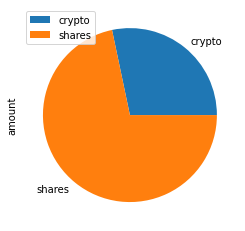

In [92]:
# Plot savings pie chart
# YOUR CODE HERE!
df_savings.plot(kind='pie', subplots=True)

In [96]:
# Set ideal emergency fund
emergency_fund = monthly_income * 3

# Calculate total amount of savings
# YOUR CODE HERE!
total_savings = crypto_value + stocks_value

# Validate saving health
# YOUR CODE HERE!
if total_savings > emergency_fund:
    print(f"Congratulations, you have surpassed your Emergency Fund goal!")
elif total_savings == emergency_fund:
    print(f"Congratulations, you have reached your Emergency Fund goal!")
else:
    print(f"You need to save {emergency_fund - total_savings} to reach your Emergency Fund goal.")


Congratulations, you have surpassed your Emergency Fund goal!


## Part 2 - Retirement Planning

### Monte Carlo Simulation

In [110]:
# Set start and end dates of five years back from today.
# Sample results may vary from the solution based on the time frame chosen
import datetime
end_date = pd.Timestamp(date.today(), tz='America/New_York').isoformat()
start_date = pd.Timestamp(datetime.date(date.today().year - 5, date.today().month, date.today().day), tz='America/New_York').isoformat()
## This code isn't perfect, because it doesn't take into account leap years at all, but it will get us in the ballpark


In [141]:
# Get 5 years' worth of historical data for SPY and AGG
# YOUR CODE HERE!
df_stock_data = alpaca.get_barset(
    tickers,
    timeframe,
    start=start_date,
    end=end_date
).df

# Display sample data
df_stock_data.head()

AGG                                         SPY  \
                             open     high     low   close     volume    open   
2015-10-19 00:00:00-04:00  109.78  109.895  109.65  109.85  1289942.0  202.50   
2015-10-20 00:00:00-04:00  109.64  109.780  109.55  109.65  1672562.0  202.85   
2015-10-21 00:00:00-04:00  109.73  109.950  109.73  109.89  1119723.0  203.61   
2015-10-22 00:00:00-04:00  109.90  110.050  109.83  109.94  1817244.0  202.98   
2015-10-23 00:00:00-04:00  109.79  109.790  109.69  109.74  1344632.0  207.25   

                                                                
                             high       low   close     volume  
2015-10-19 00:00:00-04:00  203.37  202.1300  203.33   61255929  
2015-10-20 00:00:00-04:00  203.84  202.5471  203.07   60081395  
2015-10-21 00:00:00-04:00  203.79  201.6500  201.82   83704739  
2015-10-22 00:00:00-04:00  205.51  202.8100  205.22  121670959  
2015-10-23 00:00:00-04:00  207.95  206.3000  207.51  103135843

In [173]:
# Configuring a Monte Carlo simulation to forecast 30 years cumulative returns
# YOUR CODE HERE!
num_sims = 500
years = 30
weights = [0.4, 0.6]

mc_portfolio = MCSimulation(
    portfolio_data = df_stock_data,
    weights = weights,
    num_simulation = num_sims, 
    num_trading_days = 252 * years
)

In [174]:
# Printing the simulation input data
# YOUR CODE HERE!
df_stock_data


AGG                                          \
                             open      high       low    close     volume   
2015-10-19 00:00:00-04:00  109.78  109.8950  109.6500  109.850  1289942.0   
2015-10-20 00:00:00-04:00  109.64  109.7800  109.5500  109.650  1672562.0   
2015-10-21 00:00:00-04:00  109.73  109.9500  109.7300  109.890  1119723.0   
2015-10-22 00:00:00-04:00  109.90  110.0500  109.8300  109.940  1817244.0   
2015-10-23 00:00:00-04:00  109.79  109.7900  109.6900  109.740  1344632.0   
...                           ...       ...       ...      ...        ...   
2020-10-13 00:00:00-04:00  118.01  118.0700  117.9294  118.010  3250338.0   
2020-10-14 00:00:00-04:00  118.10  118.1100  117.9850  118.040  3295967.0   
2020-10-15 00:00:00-04:00  118.15  118.1500  117.9600  117.970  4988612.0   
2020-10-16 00:00:00-04:00  117.99  118.0778  117.8800  117.880  3589312.0   
2020-10-19 00:00:00-04:00  117.81  117.8600  117.7200  117.787  3895071.0   

                              SPY                                         
                             open      high       low   close     volume  
2015-10-19 00:00:00-04:00  202.50  203.3700  202.1300  203.33   61255929  
2015-10-20 00:00:00-04:00  202.85  203.8400  202.5471  203.07   60081395  
2015-10-21 00:00:00-04:00  203.61  203.7900  201.6500  201.82   83704739  
2015-10-22 00:00:00-04:00  202.98  205.5100  202.8100  205.22  121670959  
2015-10-23 00:00:00-04:00  207.25  207.9500  206.3000  207.51  103135843  
...                           ...       ...       ...     ...        ...  
2020-10-13 00:00:00-04:00  352.28  352.4651  349.0900  350.15   62272512  
2020-10-14 00:00:00-04:00  350.75  351.9300  347.1400  347.97   47281475  
2020-10-15 00:00:00-04:00  343.71  348.0200  343.1300  347.51   50665477  
2020-10-16 00:00:00-04:00  348.96  350.7500  347.1000  347.25   62467863  
2020-10-19 00:00:00-04:00  348.62  349.3300  341.0400  342.02   51690440  

[1260 rows x 10 columns]

In [175]:
# Running a Monte Carlo simulation to forecast 30 years cumulative returns
# YOUR CODE HERE!

mc_portfolio.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,1.002536,1.005317,1.006864,0.998400,0.991303,0.996972,0.997343,1.008041,1.017656,0.998253,...,0.990622,0.990645,1.001746,1.006890,1.001604,0.999837,1.007108,1.009587,0.997406,0.998088
2,1.000115,0.998241,0.998440,0.999738,0.999190,1.001245,0.990325,1.005665,1.010897,1.004361,...,0.991559,0.995502,1.008133,1.001327,1.002959,1.012043,1.015819,1.015812,0.992699,0.979279
3,1.002240,1.010775,1.000978,0.989728,1.005890,0.997871,0.998555,1.008096,0.994595,1.000915,...,0.988617,0.997447,0.999898,1.004542,0.997593,1.004489,1.013902,1.023487,0.993049,0.967383
4,0.991193,1.009800,1.000510,0.991492,1.006823,0.993289,0.988470,0.996094,0.992959,1.012674,...,0.986247,0.985039,1.004394,0.990536,1.001737,1.002519,1.013085,1.027056,0.984512,0.963658
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7556,14.170177,3.317160,6.898081,7.535317,18.622642,4.976564,3.425082,8.922837,2.207501,11.594243,...,10.587480,24.477854,5.801276,5.854124,3.070315,26.095577,10.241952,5.991843,8.255567,13.249573
7557,14.171677,3.297532,6.978856,7.525092,18.639267,4.954047,3.402177,8.925413,2.230104,11.653901,...,10.596720,24.563792,5.827131,5.843072,3.048167,25.946784,10.229540,5.996401,8.249965,13.352483
7558,13.970873,3.287562,6.947872,7.493442,18.495936,4.959546,3.412416,8.925965,2.239426,11.694720,...,10.601573,24.380714,5.801745,5.865418,3.042459,26.202012,10.195081,6.046692,8.233390,13.323388
7559,13.865687,3.336893,6.874143,7.612926,18.532223,4.989205,3.415358,8.843354,2.223306,11.809415,...,10.505388,24.298294,5.830733,5.875612,3.020829,26.474566,10.241227,6.103672,8.096005,13.405964


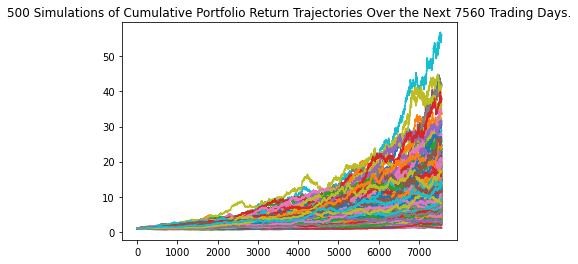

In [176]:
# Plot simulation outcomes
# YOUR CODE HERE!
line_plot = mc_portfolio.plot_simulation()

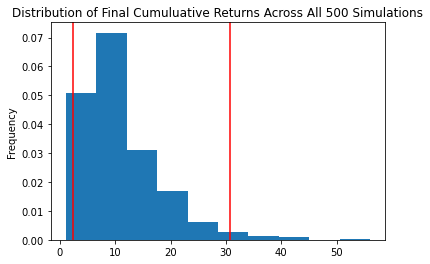

In [180]:
# Plot probability distribution and confidence intervals
# YOUR CODE HERE!
histogram = mc_portfolio.plot_distribution()

### Retirement Analysis

In [181]:
# Fetch summary statistics from the Monte Carlo simulation results
# YOUR CODE HERE!
port_stats = mc_portfolio.summarize_cumulative_return()

# Print summary statistics
# YOUR CODE HERE!
print(port_stats)

count           500.000000
mean             11.053587
std               7.306761
min               1.053575
25%               6.107328
50%               9.208527
75%              14.239957
max              56.031917
95% CI Lower      2.341181
95% CI Upper     30.693886
Name: 7560, dtype: float64


### Calculate the expected portfolio return at the 95% lower and upper confidence intervals based on a `$20,000` initial investment.

In [182]:
# Set initial investment
initial_investment = 20000

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $20,000
# YOUR CODE HERE!
ci_lower = format(port_stats[8] * initial_investment, '.2f')
ci_upper = format(port_stats[9] * initial_investment, '.2f')

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${ci_lower} to ${ci_upper}")

There is a 95% chance that an initial investment of $20000 in the portfolio over the next 30 years will end within in the range of $46823.62 to $613877.73


### Calculate the expected portfolio return at the `95%` lower and upper confidence intervals based on a `50%` increase in the initial investment.

In [199]:
# Set initial investment
initial_investment = 20000 * 1.5

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $30,000
# YOUR CODE HERE!
ci_lower = format(port_stats[8] * initial_investment, '.2f')
ci_upper = format(port_stats[9] * initial_investment, '.2f')

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${ci_lower} and ${ci_upper}")

There is a 95% chance that an initial investment of $30000.0 in the portfolio over the next 30 years will end within in the range of $23876.94 and $90054.31


## Optional Challenge - Early Retirement


### Five Years Retirement Option

In [200]:
# Configuring a Monte Carlo simulation to forecast 5 years cumulative returns
# YOUR CODE HERE!
num_sims = 500
years = 5
weights = [0.3, 0.7]

mc_portfolio = MCSimulation(
    portfolio_data = df_stock_data,
    weights = weights,
    num_simulation = num_sims, 
    num_trading_days = 252 * years
)

In [201]:
# Running a Monte Carlo simulation to forecast 5 years cumulative returns
# YOUR CODE HERE!
mc_portfolio.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,1.004998,1.005836,0.991871,0.993003,0.993742,0.999343,0.988355,1.004502,0.997671,1.010981,...,1.001936,0.995877,0.990542,0.998007,0.991473,1.000627,1.013062,1.008108,0.997273,0.992999
2,1.017607,1.016982,0.996728,0.995024,0.995392,0.996011,0.982489,0.996065,1.009354,1.010467,...,1.005459,0.991548,0.997092,0.992529,0.998738,0.998753,1.017794,1.006649,1.007812,0.991924
3,1.017093,1.012698,0.992476,0.991142,1.003780,0.983703,0.994759,1.005888,1.023239,0.988943,...,1.004102,0.989191,0.997497,0.986161,1.002518,0.994505,1.020467,1.003268,1.008357,0.995856
4,1.019774,1.008912,0.980866,0.990192,1.003788,0.999563,0.987752,1.011677,1.018065,1.000629,...,1.010687,0.973728,1.004178,0.989001,0.998025,0.992735,1.028509,1.005009,0.992678,1.003958
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1256,1.127899,1.332413,1.859109,1.834797,2.836941,1.653585,1.765254,1.555558,1.433377,1.240632,...,2.029198,1.490604,1.949572,1.391451,1.185359,1.346207,1.523612,1.883106,1.912811,1.167815
1257,1.126204,1.320534,1.853139,1.833010,2.841665,1.656739,1.731110,1.538308,1.431560,1.223677,...,2.019491,1.481540,1.957304,1.409426,1.191216,1.351659,1.516992,1.873233,1.929053,1.167714
1258,1.120319,1.328143,1.888057,1.811618,2.809798,1.661083,1.728842,1.526642,1.438089,1.208362,...,2.008599,1.470457,1.947694,1.411958,1.200144,1.346638,1.519931,1.860014,1.934903,1.168668
1259,1.116560,1.333495,1.868356,1.811786,2.833440,1.640620,1.733554,1.535195,1.449292,1.187103,...,2.013777,1.478121,1.942532,1.411512,1.187718,1.334984,1.529784,1.889441,1.945258,1.174654


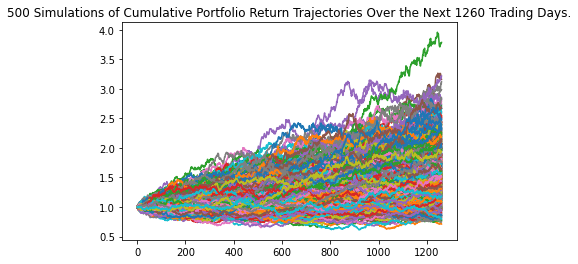

In [202]:
# Plot simulation outcomes
# YOUR CODE HERE!
line_plot = mc_portfolio.plot_simulation()

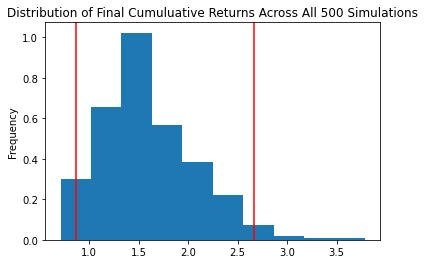

In [203]:
# Plot probability distribution and confidence intervals
# YOUR CODE HERE!
histogram = mc_portfolio.plot_distribution()

In [204]:
# Fetch summary statistics from the Monte Carlo simulation results
# YOUR CODE HERE!
port_stats = mc_portfolio.summarize_cumulative_return()

# Print summary statistics
# YOUR CODE HERE!
print(port_stats)

count           500.000000
mean              1.599116
std               0.467234
min               0.711890
25%               1.274723
50%               1.528633
75%               1.875392
max               3.784023
95% CI Lower      0.866086
95% CI Upper      2.668016
Name: 1260, dtype: float64


In [205]:
# Set initial investment
# YOUR CODE HERE!
initial_investment = 20000

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $20,000
# YOUR CODE HERE!
ci_lower_five = format(port_stats[8] * initial_investment, '.2f')
ci_upper_five = format(port_stats[9] * initial_investment, '.2f')

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 5 years will end within in the range of"
      f" ${ci_lower_five} and ${ci_upper_five}")

There is a 95% chance that an initial investment of $20000 in the portfolio over the next 5 years will end within in the range of $17321.73 and $53360.31


### Ten Years Retirement Option

In [30]:
# Configuring a Monte Carlo simulation to forecast 10 years cumulative returns
# YOUR CODE HERE!

In [31]:
# Running a Monte Carlo simulation to forecast 10 years cumulative returns
# YOUR CODE HERE!

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,0.997817,0.998428,1.000816,1.000202,1.002120,0.998788,1.004226,1.004250,1.001431,1.000740,...,0.995519,1.001253,1.000492,0.994026,1.006129,1.002356,1.005233,0.999769,1.002106,1.003746
2,0.994703,0.996223,1.001987,0.998816,1.002372,0.996708,1.009074,1.006986,1.006219,0.995591,...,0.991815,1.001091,1.003774,0.989341,1.007530,1.009809,1.007273,0.999666,1.006340,0.998303
3,0.994115,0.993375,0.992622,1.001069,0.999700,1.000123,1.011610,1.009254,1.012194,0.998619,...,0.992699,1.003085,1.005997,0.991536,1.004239,1.010765,1.009501,0.999652,1.011737,0.998762
4,0.999040,0.997821,0.992272,0.999767,1.000459,1.006178,1.008906,1.009897,1.014282,0.995619,...,0.997683,1.007825,1.007858,0.991188,1.009171,1.009303,1.008223,1.003270,1.014350,1.001691
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2516,2.164254,1.246948,1.441080,1.685210,1.702114,1.474774,1.535126,1.288182,1.138653,1.500977,...,1.367442,1.357662,1.661583,1.348599,1.649220,1.782632,1.450872,1.701338,1.199957,1.171159
2517,2.169555,1.246315,1.436260,1.685058,1.697652,1.479128,1.536203,1.288485,1.144082,1.498097,...,1.366833,1.360457,1.672969,1.351751,1.646287,1.781356,1.459438,1.695322,1.197466,1.171882
2518,2.169089,1.243387,1.426446,1.685480,1.714264,1.479079,1.537777,1.289258,1.140795,1.496271,...,1.368088,1.357853,1.662915,1.354957,1.637911,1.781046,1.451367,1.695901,1.201111,1.172847
2519,2.170695,1.238881,1.419187,1.670521,1.720418,1.478161,1.544292,1.296500,1.137510,1.499085,...,1.370125,1.359697,1.664317,1.352170,1.633762,1.778638,1.443413,1.699061,1.191529,1.166331


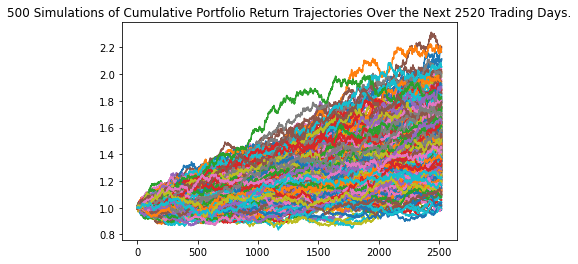

In [32]:
# Plot simulation outcomes
# YOUR CODE HERE!

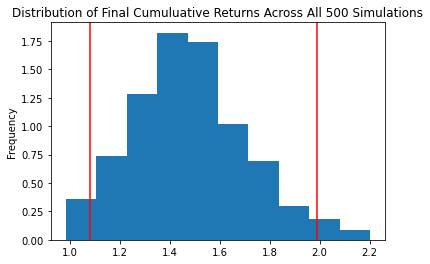

In [33]:
# Plot probability distribution and confidence intervals
# YOUR CODE HERE!

In [34]:
# Fetch summary statistics from the Monte Carlo simulation results
# YOUR CODE HERE!

# Print summary statistics
# YOUR CODE HERE!

count           500.000000
mean              1.477364
std               0.230147
min               0.984413
25%               1.319127
50%               1.468676
75%               1.613270
max               2.202006
95% CI Lower      1.083048
95% CI Upper      1.990417
Name: 2520, dtype: float64


In [35]:
# Set initial investment
# YOUR CODE HERE!

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60,000
# YOUR CODE HERE!

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 10 years will end within in the range of"
      f" ${ci_lower_ten} and ${ci_upper_ten}")

There is a 95% chance that an initial investment of $60000 in the portfolio over the next 30 years will end within in the range of $64982.9 and $119425.0
